In [ ]:
import numpy as np
import pandas as pd
import tqdm
import re
import math
from io import BytesIO
from PIL import Image
import requests
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics import pairwise_distances
from sklearn.metrics.pairwise import cosine_similarity
import gensim
from sklearn import preprocessing
from scipy.sparse import coo_matrix, csr_matrix
from scipy.sparse.linalg import svds

# Предобработка данных

In [ ]:
books = pd.read_csv("BX-Books.csv")

D:\bmstu\Anaconda\lib\site-packages\IPython\core\interactiveshell.py:3071: DtypeWarning: Columns (3) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [ ]:
books.head(5)

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
0,0195153448,Classical Mythology,Mark P. O. Morford,2002,Oxford University Press,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...
1,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...
2,0060973129,Decision in Normandy,Carlo D'Este,1991,HarperPerennial,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...
3,0374157065,Flu: The Story of the Great Influenza Pandemic...,Gina Bari Kolata,1999,Farrar Straus Giroux,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...
4,0393045218,The Mummies of Urumchi,E. J. W. Barber,1999,W. W. Norton &amp; Company,http://images.amazon.com/images/P/0393045218.0...,http://images.amazon.com/images/P/0393045218.0...,http://images.amazon.com/images/P/0393045218.0...


In [ ]:
books.shape

(271360, 8)

In [ ]:
books.drop(['Image-URL-S', 'Image-URL-L'], axis = 1, inplace = True)

In [ ]:
books = books[(books['Year-Of-Publication'] != 'DK Publishing Inc') & (books['Year-Of-Publication'] != 'Gallimard')]

In [ ]:
books = books[(books['Year-Of-Publication'].astype(int) > 1700) & (books['Year-Of-Publication'].astype(int) < 2020)]

In [ ]:
books.head(5)

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-M
0,0195153448,Classical Mythology,Mark P. O. Morford,2002,Oxford University Press,http://images.amazon.com/images/P/0195153448.0...
1,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...
2,0060973129,Decision in Normandy,Carlo D'Este,1991,HarperPerennial,http://images.amazon.com/images/P/0060973129.0...
3,0374157065,Flu: The Story of the Great Influenza Pandemic...,Gina Bari Kolata,1999,Farrar Straus Giroux,http://images.amazon.com/images/P/0374157065.0...
4,0393045218,The Mummies of Urumchi,E. J. W. Barber,1999,W. W. Norton &amp; Company,http://images.amazon.com/images/P/0393045218.0...


In [ ]:
books.shape

(266720, 6)

In [ ]:
Int = pd.read_csv("BX-Book-Ratings.csv", sep = ";", encoding = "ISO-8859-1")

In [ ]:
Int.head(5)

,User-ID,ISBN,Book-Rating
0,276725,034545104X,0
1,276726,0155061224,5
2,276727,0446520802,0
3,276729,052165615X,3
4,276729,0521795028,6


In [ ]:
Int.shape

(1149780, 3)

In [ ]:
Int = Int[Int["Book-Rating"] != 0]

In [ ]:
Int.shape

(433671, 3)

In [ ]:
books_meets = Int.groupby("ISBN")["User-ID"].count().reset_index().rename(columns = {"User-ID": "user_num"})

In [ ]:
books_meets.head(5)

,ISBN,user_num
0,0330299891,1
1,0375404120,1
2,9022906116,1
3,#6612432,1
4,'9607092910',1


In [ ]:
user_meets = Int.groupby("User-ID")["ISBN"].count().reset_index().rename(columns = {"ISBN": "books_num"})

In [ ]:
user_meets.head(5)

,User-ID,books_num
0,8,7
1,9,1
2,10,1
3,12,1
4,14,3


In [ ]:
Int = Int.merge(books_meets, on = ["ISBN"]).merge(user_meets, on = ["User-ID"])

In [ ]:
Int.head(5)

,User-ID,ISBN,Book-Rating,user_num,books_num
0,276726,0155061224,5,1,1
1,276729,052165615X,3,1,2
2,276729,0521795028,6,1,2
3,276736,3257224281,8,4,1
4,86583,3257224281,6,4,18


In [ ]:
Int.shape

(433671, 5)

In [ ]:
Int = Int[(Int["user_num"] > 5) & (Int["books_num"] > 5) & (Int["books_num"] < 200)]

In [ ]:
Int.shape

(113889, 5)

In [ ]:
users = pd.read_csv('BX-Users.csv', delimiter = ';', encoding = 'ISO-8859-1')

In [ ]:
users.head(5)

,User-ID,Location,Age
0,1,"nyc, new york, usa",NaN
1,2,"stockton, california, usa",18.0
2,3,"moscow, yukon territory, russia",NaN
3,4,"porto, v.n.gaia, portugal",17.0
4,5,"farnborough, hants, united kingdom",NaN


In [ ]:
users.shape

(278858, 3)

In [ ]:
users = users[(users["Age"] > 5) & (users["Age"] < 90)]

In [ ]:
users.head(5)

,User-ID,Location,Age
1,2,"stockton, california, usa",18.0
3,4,"porto, v.n.gaia, portugal",17.0
5,6,"santa monica, california, usa",61.0
9,10,"albacete, wisconsin, spain",26.0
10,11,"melbourne, victoria, australia",14.0


In [ ]:
users.shape

(166753, 3)

In [ ]:
Int = Int.merge(books[["ISBN", "Image-URL-M", "Book-Title"]].rename(columns = {"Image-URL-M": "picture_url"}), on=["ISBN"])

In [ ]:
Int.head(5)

,User-ID,ISBN,Book-Rating,user_num,books_num,picture_url,Book-Title
0,86583,3404139178,9,8,18,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman
1,132500,3404139178,10,8,43,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman
2,66483,3404139178,10,8,83,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman
3,276866,3404139178,9,8,11,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman
4,106534,3404139178,6,8,6,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman


In [ ]:
Int.shape

(109542, 7)

In [ ]:
Int = Int.merge(users[["User-ID", "Age", "Location"]], on = ["User-ID"], how = 'left')

In [ ]:
le = preprocessing.LabelEncoder()

In [ ]:
Int["product_id"] = le.fit_transform(Int["ISBN"])
Int["vid"] = le.fit_transform(Int["User-ID"])

In [ ]:
Int.shape

(109542, 11)

In [ ]:
Int.head(5)

,User-ID,ISBN,Book-Rating,user_num,books_num,picture_url,Book-Title,Age,Location,product_id,vid
0,86583,3404139178,9,8,18,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,31.0,"stuttgart, , germany",10268,3426
1,132500,3404139178,10,8,43,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,29.0,"fürth, ,",10268,5220
2,66483,3404139178,10,8,83,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,16.0,"berlin, berlin, germany",10268,2608
3,276866,3404139178,9,8,11,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,27.0,"mönchengladbach, nordrhein-westfalen, germany",10268,10830
4,106534,3404139178,6,8,6,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,18.0,"pratteln, baselland, switzerland",10268,4205


In [ ]:
Int.shape

(109542, 11)

In [ ]:
def chunks(l, n):
    for i in range(0, len(l), n):
        yield l[i:i + n]

def rec_imaging(product_ids, content_dict, measure = None, top_n = 5):
    picture_urls = [content_dict[i] for i in product_ids]
    cnt = 0
    for idx, chunk in enumerate(chunks(picture_urls, top_n)):
        fig = plt.figure(figsize=(20, 4))
        for n, i in enumerate(chunk):
            try:
                r = requests.get(i)
                im = Image.open(BytesIO(r.content))

            except:
                print('Something went wrong with {url}'.format(url=i))
                continue

            a = fig.add_subplot(1, top_n, n + 1)
            if measure is not None:
                a.title.set_text("measure = {}".format(np.round(measure[cnt], 4)))
                cnt += 1
            plt.imshow(im)
            plt.axis('off')
        plt.show()

# Персональный топ

In [ ]:
product_id_to_url = {}

for i in Int[["product_id", "picture_url"]].drop_duplicates().values:
    product_id_to_url[i[0]] = i[1]
        
def personal_top(Age, Location):
    personal_books = Int[(Int["Age"] == Age) & (Int["Location"] == Location)]\
                                                                            .groupby("product_id")["Book-Rating"].mean()\
                                                                            .reset_index()\
                                                                            .sort_values("Book-Rating", ascending = False)[:10]
    
    print('Для пользователя из {} с возрастом {} лет такой топ книг:'.format(Location, Age))    
    rec_imaging(personal_books["product_id"].values, product_id_to_url, personal_books["Book-Rating"].values)

Для пользователя из williamsburg/norfolk, virginia, usa с возрастом 19.0 лет такой топ книг:


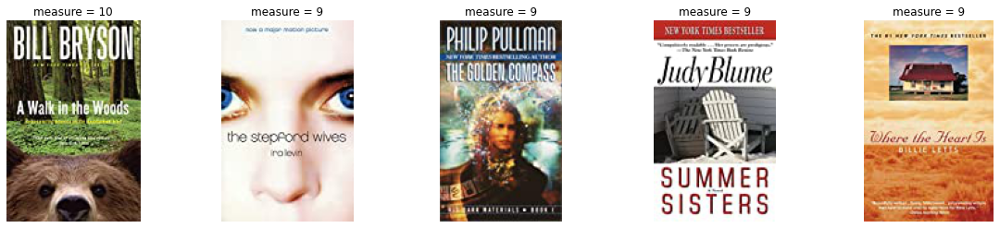

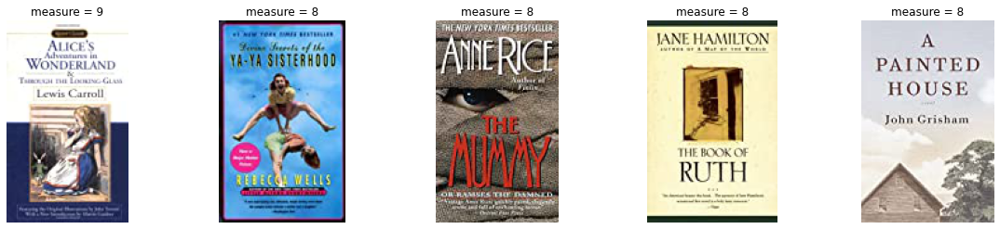

In [ ]:
personal_top(Int["Age"][55], Int["Location"][55])

Для пользователя из charleston, south carolina, usa с возрастом 30.0 лет такой топ книг:


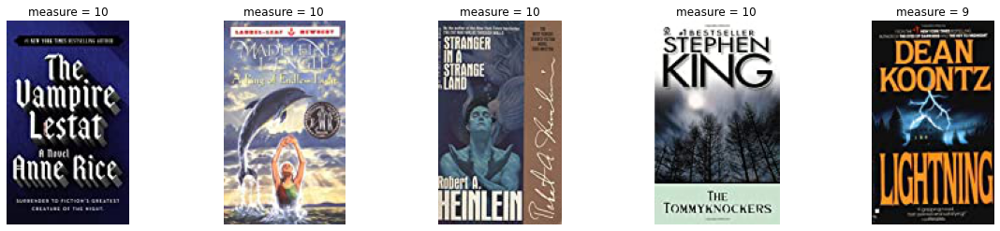

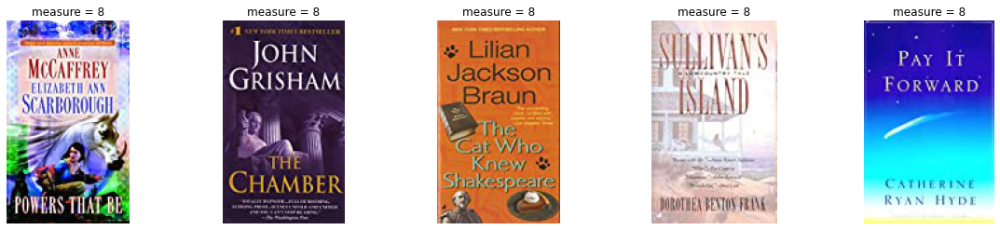

In [ ]:
personal_top(Int["Age"][45678], Int["Location"][45678])

Для пользователя из fort myers, florida, usa с возрастом 36.0 лет такой топ книг:


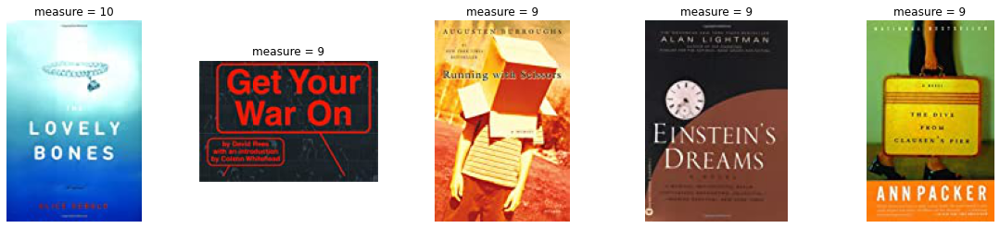

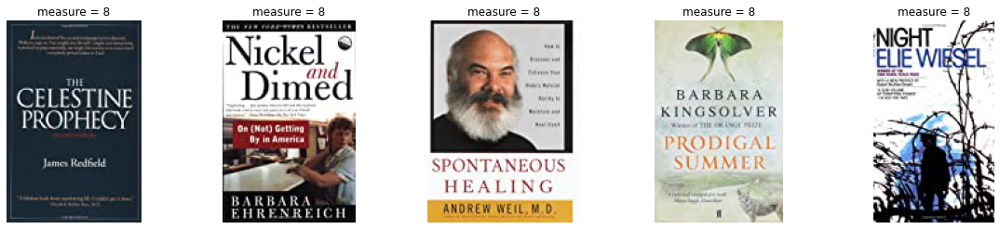

In [ ]:
personal_top(Int["Age"][1451], Int["Location"][1451])

Для пользователя из stuttgart, , germany с возрастом 31.0 лет такой топ книг:


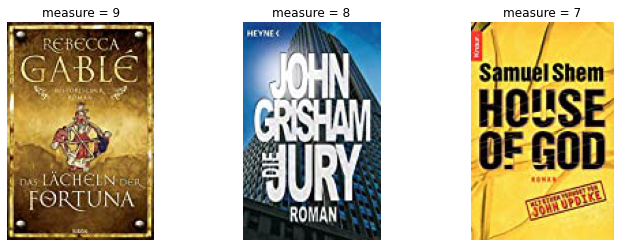

In [ ]:
personal_top(Int["Age"][13], Int["Location"][13])

Для пользователя из roanoke, texas, usa с возрастом 34.0 лет такой топ книг:


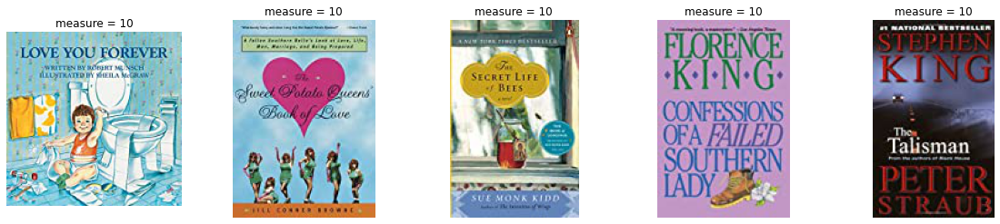

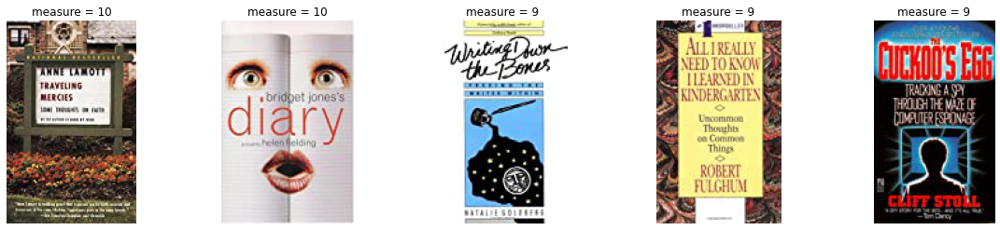

In [ ]:
personal_top(Int["Age"][5678], Int["Location"][5678])

#   Рекомендации на основе метода кластеризации похожих пользователей  

In [ ]:
product_id_to_url = {}

for i in Int[["product_id", "picture_url"]].drop_duplicates().values:
    product_id_to_url[i[0]] = i[1]

In [ ]:
csr_rates = coo_matrix((Int["Book-Rating"], (Int["vid"], Int["product_id"])), 
                            shape = (len(set(Int["vid"])), len(set(Int["product_id"]))))

In [ ]:
S = pairwise_distances(csr_rates, metric = 'cosine')

In [ ]:
norm_list = []
for i in range(S.shape[0]):
    norm_list.append(round(np.linalg.norm(S[i]) - 103, 2))

In [ ]:
np.unique(norm_list)

array([0.03, 0.13, 0.24, 0.27, 0.29, 0.3 , 0.31, 0.33, 0.35, 0.36, 0.37,
       0.38, 0.39, 0.4 , 0.41, 0.42, 0.43, 0.45, 0.46, 0.47, 0.48, 0.49,
       0.5 , 0.51, 0.52, 0.53, 0.54, 0.55, 0.56, 0.57, 0.58, 0.59, 0.6 ,
       0.61, 0.62, 0.63, 0.64, 0.65, 0.66, 0.67, 0.68, 0.69, 0.7 , 0.71,
       0.72, 0.73, 0.74, 0.75, 0.76, 0.77, 0.78, 0.79, 0.8 , 0.81, 0.82,
       0.83, 0.84, 0.85, 0.86, 0.87, 0.88, 0.89, 0.9 , 0.91, 0.92, 0.93,
       0.94, 0.95, 0.96, 0.97, 0.98, 0.99, 1.  , 1.01, 1.02, 1.03, 1.04,
       1.05, 1.06, 1.07, 1.08, 1.09, 1.1 , 1.11, 1.12, 1.13, 1.14, 1.15,
       1.16, 1.17, 1.18, 1.19, 1.2 , 1.21, 1.22, 1.23, 1.24, 1.25, 1.26,
       1.27, 1.28, 1.29, 1.3 , 1.31, 1.32, 1.33, 1.34, 1.35, 1.36, 1.37,
       1.38, 1.39, 1.4 , 1.41])

In [ ]:
ind_klusters = []
ind_kluster_1 = []
ind_kluster_2 = []
ind_kluster_3 = []
ind_kluster_4 = []
ind_kluster_5 = []
ind_kluster_6 = []
ind_kluster_7 = []
ind_kluster_8 = []
ind_kluster_9 = []
ind_kluster_10 = []
ind_kluster_11 = []
ind_kluster_12 = []
for i in range(len(norm_list)):
    if (norm_list[i] >= 0.03) & (norm_list[i] < 0.14):
        ind_kluster_1.append(i)
    if (norm_list[i] >= 0.14) & (norm_list[i] < 0.36):
        ind_kluster_2.append(i)
    if (norm_list[i] >= 0.36) & (norm_list[i] < 0.46):
        ind_kluster_3.append(i)
    if (norm_list[i] >= 0.46) & (norm_list[i] < 0.56):
        ind_kluster_4.append(i)
    if (norm_list[i] >= 0.56) & (norm_list[i] < 0.66):
        ind_kluster_5.append(i)
    if (norm_list[i] >= 0.66) & (norm_list[i] < 0.76):
        ind_kluster_6.append(i)
    if (norm_list[i] >= 0.76) & (norm_list[i] < 0.86):
        ind_kluster_7.append(i)
    if (norm_list[i] >= 0.86) & (norm_list[i] < 0.96):
        ind_kluster_8.append(i)
    if (norm_list[i] >= 0.96) & (norm_list[i] < 1.1):
        ind_kluster_9.append(i)
    if (norm_list[i] >= 1.1) & (norm_list[i] < 1.21):
        ind_kluster_10.append(i)
    if (norm_list[i] >= 1.21) & (norm_list[i] < 1.31):
        ind_kluster_11.append(i)
    if (norm_list[i] >= 1.31) & (norm_list[i] < 1.42):
        ind_kluster_12.append(i)
ind_klusters.append(ind_kluster_1)
ind_klusters.append(ind_kluster_2)
ind_klusters.append(ind_kluster_3)
ind_klusters.append(ind_kluster_4)
ind_klusters.append(ind_kluster_5)
ind_klusters.append(ind_kluster_6)
ind_klusters.append(ind_kluster_7)
ind_klusters.append(ind_kluster_8)
ind_klusters.append(ind_kluster_9)
ind_klusters.append(ind_kluster_10)
ind_klusters.append(ind_kluster_11)
ind_klusters.append(ind_kluster_12)

In [ ]:
csr_rates = csr_rates.toarray()

In [ ]:
df_matrix = pd.DataFrame(csr_rates)

In [ ]:
def top_recomendations(vid):
    
    ind_kluster = []
    top_reit = []
    ind_rec = []
    
    for i in range(len(ind_klusters)):
        for j in range(len(ind_klusters[i])):
            if ind_klusters[i][j] == vid:
                if i == 0:
                    ind_kluster = ind_kluster_1
                if i == 1:
                    ind_kluster = ind_kluster_2
                if i == 2:
                    ind_kluster = ind_kluster_3
                if i == 3:
                    ind_kluster = ind_kluster_4
                if i == 4:
                    ind_kluster = ind_kluster_5
                if i == 5:
                    ind_kluster = ind_kluster_6
                if i == 6:
                    ind_kluster = ind_kluster_7
                if i == 7:
                    ind_kluster = ind_kluster_8
                if i == 8:
                    ind_kluster = ind_kluster_9
                if i == 9:
                    ind_kluster = ind_kluster_10
                if i == 10:
                    ind_kluster = ind_kluster_11
                if i == 11:
                    ind_kluster = ind_kluster_12
                    
    row = df_matrix.iloc[ind_kluster, :].mean(axis = 0)
    temp_row = np.sort(row)[::-1]
    
    for i in range(10):
        if temp_row[i] != 0:
            top_reit.append(temp_row[i])
    
    for i in range(len(top_reit)):
        for j in range(row.shape[0]):
            if top_reit[i] == row[j]:
                ind_rec.append(j)
    
    print('Для пользователя из {} с возрастом {} такие рекомендации:'.format(Int[Int['vid'] == vid]['Location'].values[0], Int[Int['vid'] == vid]['Age'].values[0]))    
    rec_imaging(np.array(np.unique(ind_rec)), product_id_to_url)
        

Для пользователя из stuttgart, , germany с возрастом 31.0 такие рекомендации:


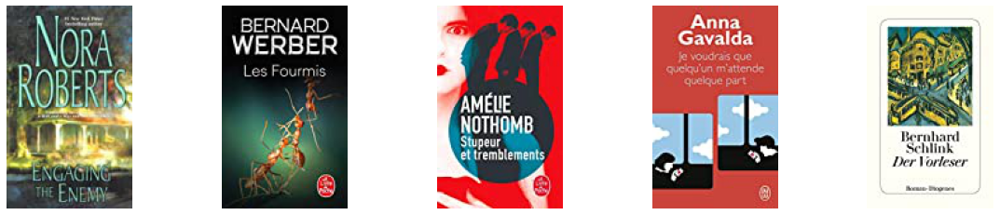

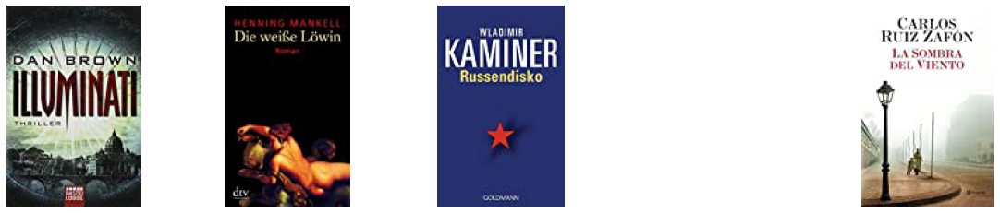

In [ ]:
top_recomendations(3426)

Для пользователя из rennes, bretagne, france с возрастом 22.0 такие рекомендации:


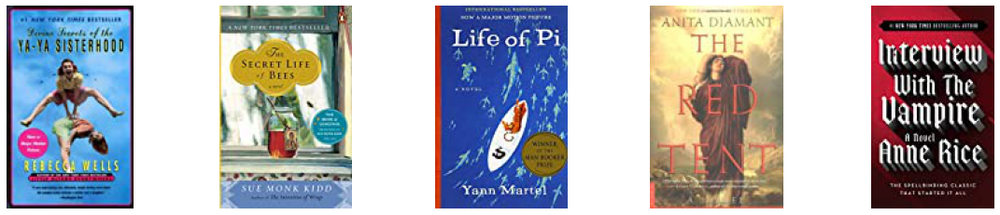

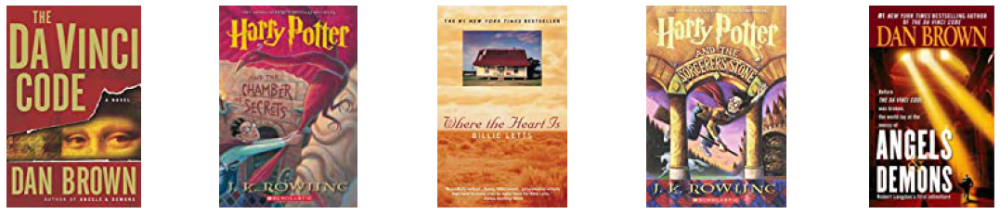

In [ ]:
top_recomendations(41)

Для пользователя из braunschweig, niedersachsen, germany с возрастом 32.0 такие рекомендации:


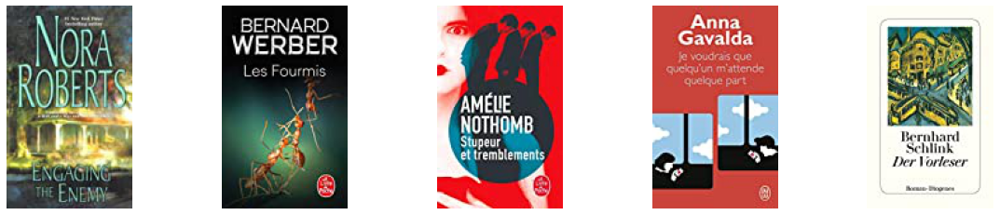

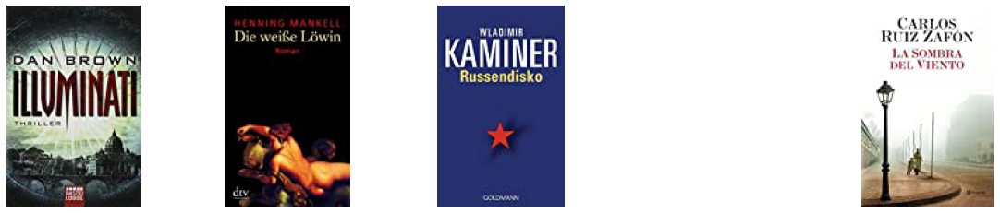

In [ ]:
top_recomendations(2606)

Для пользователя из hewitt, new jersey, usa с возрастом 44.0 такие рекомендации:


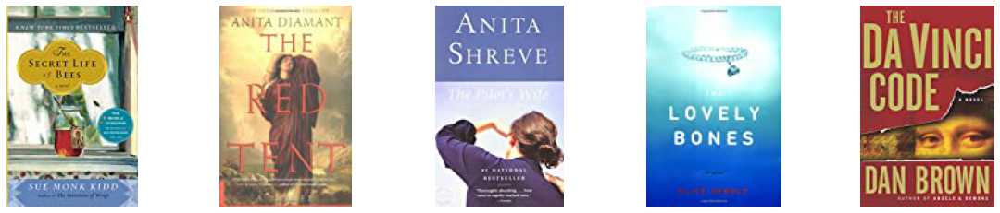

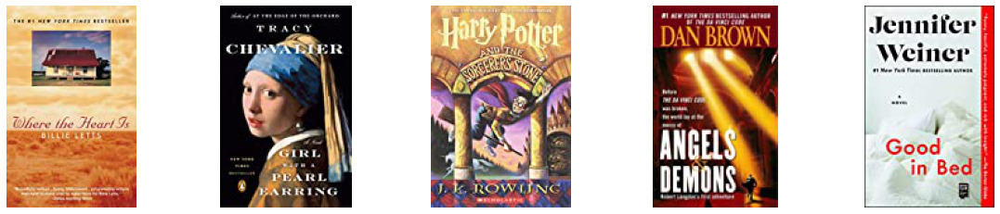

In [ ]:
top_recomendations(9764)

# Совстречаемость

In [ ]:
class Recomendations():
    def __init__(self, Int):
        self.product_id_to_url = {}
        for i in Int[["product_id", "picture_url"]].drop_duplicates().values:
            self.product_id_to_url[i[0]] = i[1]
        self.interactions = Int
        
    def coocurrency_count(self):
        Int = self.interactions[["vid", "product_id"]].drop_duplicates()
        user_products = Int.groupby(["vid"])["product_id"].apply(list).reset_index()
        user_products = user_products.merge(self.interactions.groupby(['vid'])['Book-Rating'].apply(list), on = ['vid'])
        user_products["prod_num"] = [len(i) for i in user_products["product_id"]]
        user_products = user_products[user_products["prod_num"] > 1]
        
        cooc = {}
        for i in user_products.values:
            for j in range(len(i[1])):
                for k in range(len(i[1])):
                    if j != k:
                        try:
                            cooc[str(i[1][j]) + "_" + str(i[1][k])] += np.array([np.mean([i[2][j], i[2][k]]), 1])
                        except:
                            cooc[str(i[1][j]) + "_" + str(i[1][k])] = np.array([np.mean([i[2][j], i[2][k]]), 1])
        cooc_list = []
        for i, j in cooc.items():
            if j[1] != 1:
                cooc_list.append(i.split("_") + [j[0]/j[1]])
        self.cooc_rec = pd.DataFrame(cooc_list, columns = ["item1", "item2", "measure"])

    def get_rec(self, i, show = False):
        recs = self.cooc_rec[self.cooc_rec["item1"] == str(i)]\
                            .sort_values("measure", ascending = False)\
                            .head(10)
        print(u"Для товара")
        rec_imaging([i], self.product_id_to_url)
        print(u"Такие рекомендации")
        rec_imaging(recs["item2"].values.astype(int), self.product_id_to_url, 
                         recs["measure"].values.astype(int))

In [ ]:
cooc_rec = Recomendations(Int)
cooc_rec.coocurrency_count()

Для товара


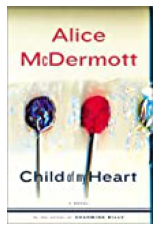

Такие рекомендации


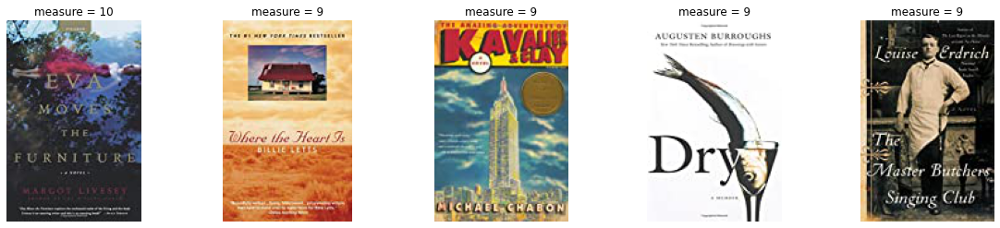

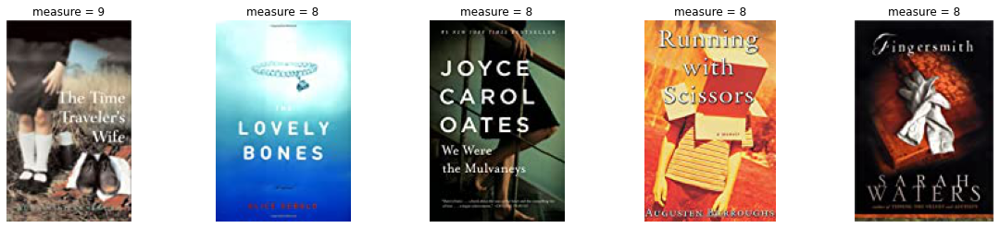

In [ ]:
cooc_rec.get_rec(2456)

Для товара


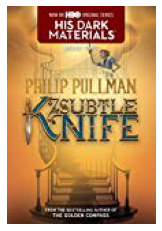

Такие рекомендации


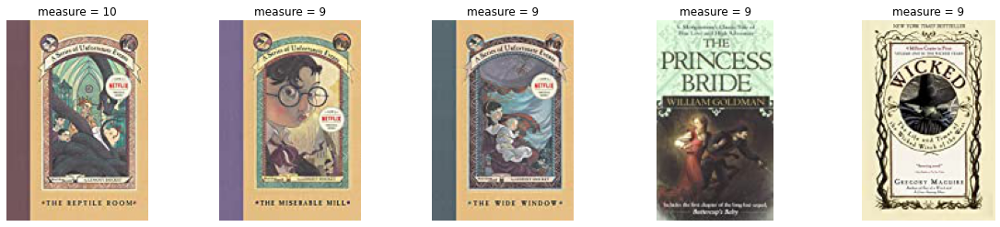

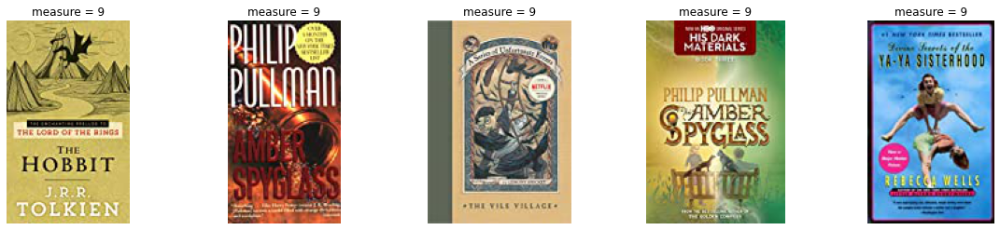

In [ ]:
cooc_rec.get_rec(4524)

Для товара


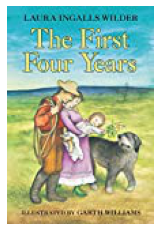

Такие рекомендации


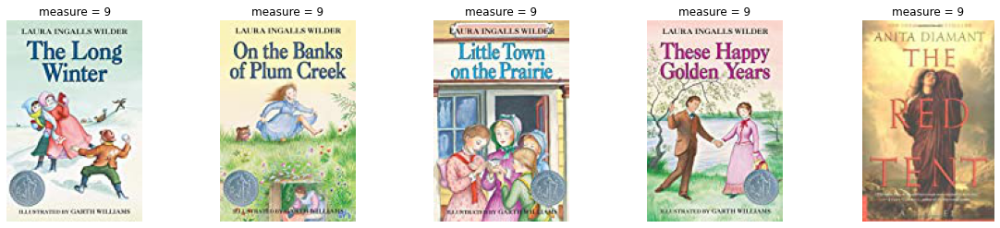

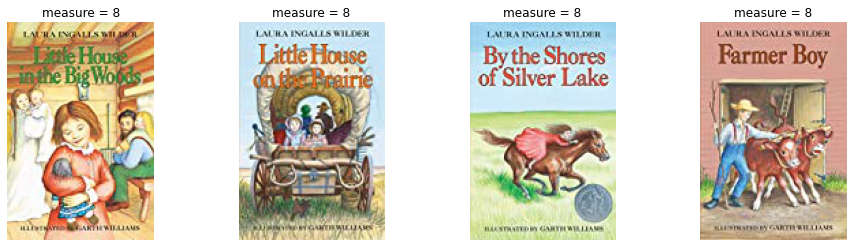

In [ ]:
cooc_rec.get_rec(666)

#  Content-based

In [ ]:
text = list(np.zeros(books.shape[0]))
items = pd.DataFrame(text, columns = ['text'])

for i in range(books.shape[0]):
    try:
        items.iloc[i, :] = re.sub(r'[^\w\s]+|[\d]+', r'', str(books['Book-Title'][i]).lower() + ' ' + str(books['Book-Author'][i]).lower() + ' ' + ' ' + str(books['Publisher'][i]).lower()).strip()
    except KeyError:
        continue

items['picture_url'] = books['Image-URL-M']

In [ ]:
for i in range(items.shape[0]):
    if items['text'][i] == 0:
        items.drop([i], inplace = True)      

In [ ]:
Int = Int.merge(items[["picture_url", "text"]].drop_duplicates(), on = ["picture_url"], how = 'left')

In [ ]:
class Content_Based():
    def __init__(self, items, interactions):
        self.items = items
        self.interactions = interactions
        self.content_dict = {}
        for i, j in enumerate(items["picture_url"]):
            self.content_dict[i] = j
        self.inversed_dict = {v: k for k, v in self.content_dict.items()}
        
    def avg_feature_vector(self, words, model, num_features, index2word_set):
        feature_vec = np.zeros((num_features, ), dtype = 'float32')
        n_words = 0
        for word in words:
            if word in index2word_set:
                n_words += 1
                feature_vec = np.add(feature_vec, model.wv[word])
        if (n_words > 0):
            feature_vec = feature_vec / n_words
        return feature_vec

    def get_items_representation(self):
        
        item_description = [gensim.utils.simple_preprocess(re.sub("[^a-zA-Zа-яА-Я]+", " ", i.lower())) for i in self.items['text']]

        self.model = gensim.models.Word2Vec(
                item_description,
                size = 200,
                window = 10,
                min_count = 1,
                workers = 10,
                iter = 100)
        self.index2word_set = set(self.model.wv.index2word)
        self.items_embs = np.zeros((len(item_description), 200))
        for i in range(self.items_embs.shape[0]):
            self.items_embs[i] = self.avg_feature_vector(item_description[i], self.model, 200, self.index2word_set)
        
        
    def get_rec_I2I(self, i):
        metrics = cosine_similarity([self.items_embs[i]], self.items_embs)
        print(u"Для товара")
        rec_imaging([i], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(np.argsort(metrics)[0][::-1][1:11], self.content_dict, np.sort(metrics)[0][::-1][1:11])


    def get_rec_U2I(self, i):
        ui = self.interactions[self.interactions["vid"] == i]
        user_vector = " ".join(ui["text"])
        user_processed = gensim.utils.simple_preprocess(re.sub("[^a-zA-Zа-яА-Я]+", " ", user_vector.lower()))
        user_emb = self.avg_feature_vector(user_processed, self.model, 200, self.index2word_set)
        metrics = cosine_similarity([user_emb], self.items_embs)
        print(u"Для пользователя, который взаимодействовал с товарами")
        rec_imaging(np.unique([self.inversed_dict[i] for i in ui["picture_url"]]), self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(np.argsort(metrics)[0][::-1][1:11], self.content_dict, np.sort(metrics)[0][::-1][1:11])

In [ ]:
CB = Content_Based(items, Int)
CB.get_items_representation()

Для товара


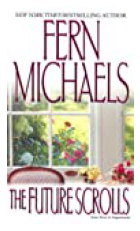

Такие рекомендации


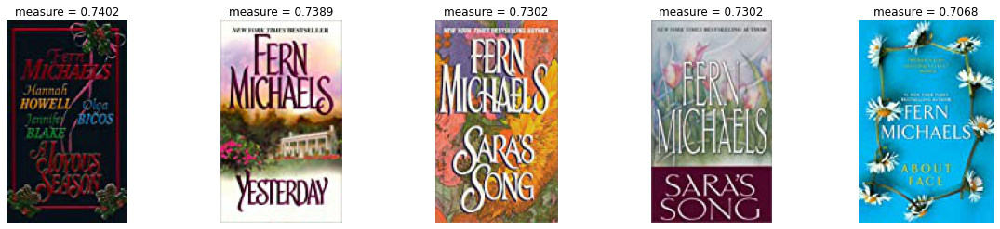

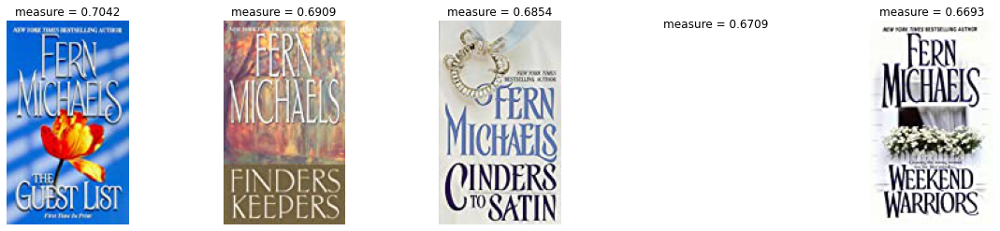

In [ ]:
CB.get_rec_I2I(666)

Для товара


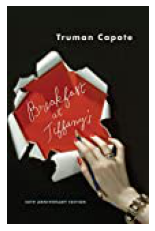

Такие рекомендации


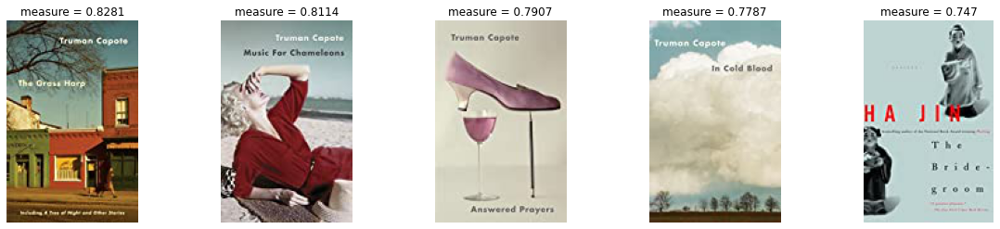

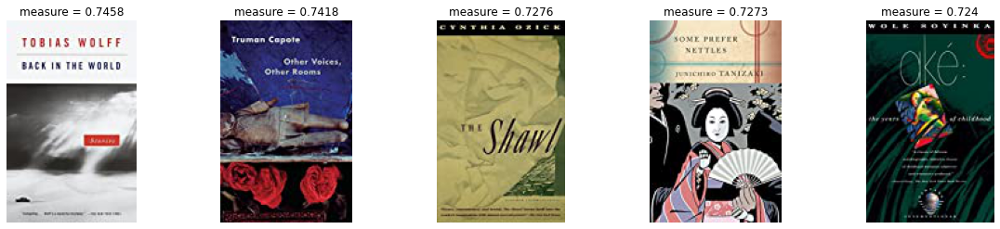

In [ ]:
CB.get_rec_I2I(1234)

Для товара


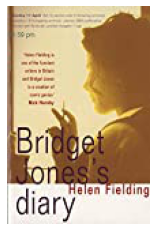

Такие рекомендации


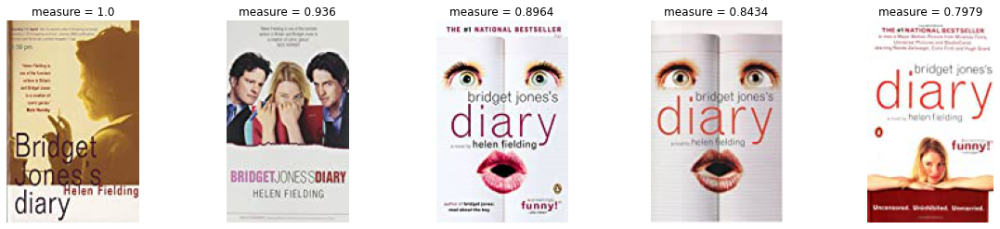

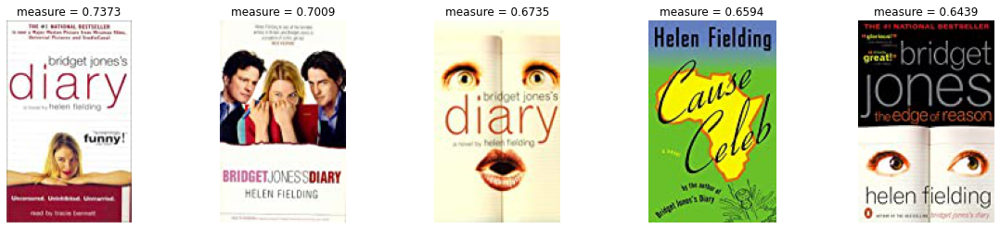

In [ ]:
CB.get_rec_I2I(166)

Для пользователя, который взаимодействовал с товарами


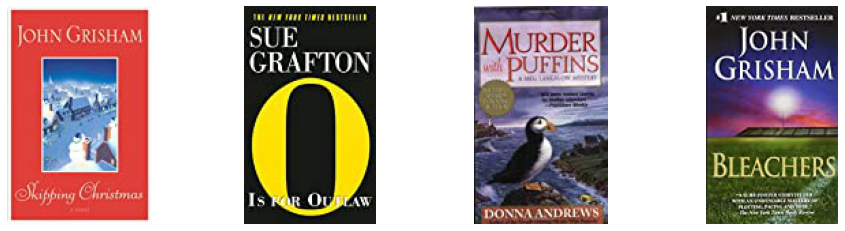

Такие рекомендации


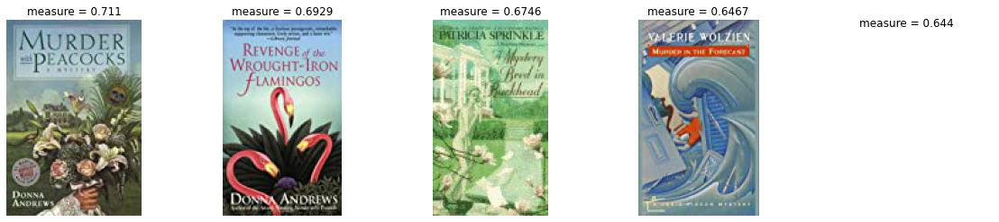

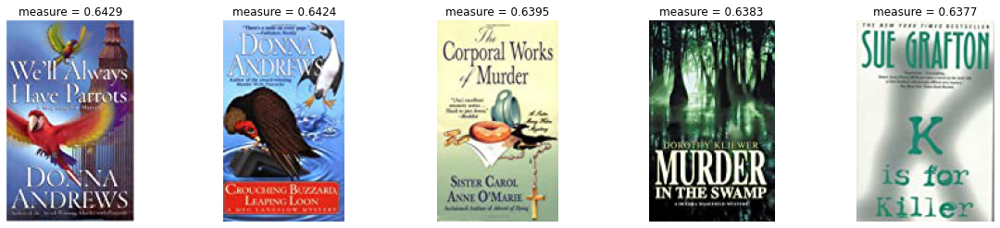

In [ ]:
CB.get_rec_U2I(1234)

Для пользователя, который взаимодействовал с товарами


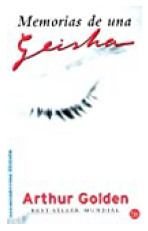

Такие рекомендации


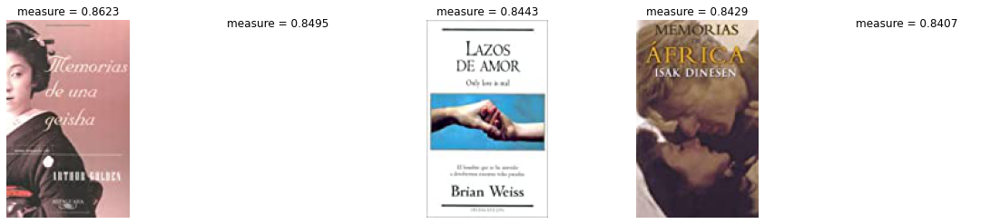

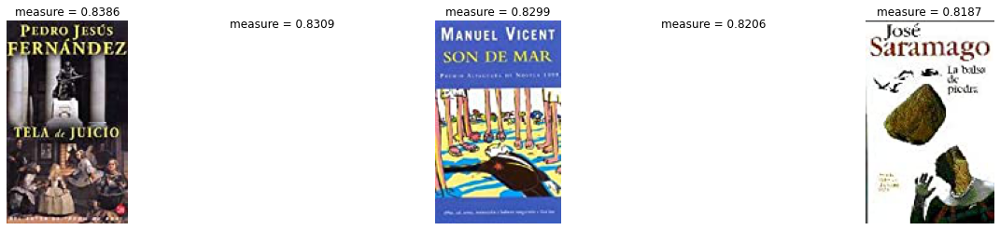

In [ ]:
CB.get_rec_U2I(5793)

Для пользователя, который взаимодействовал с товарами


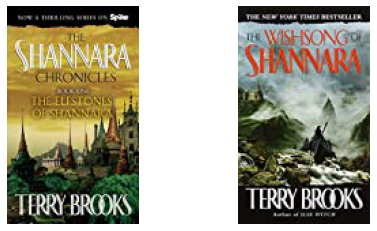

Такие рекомендации


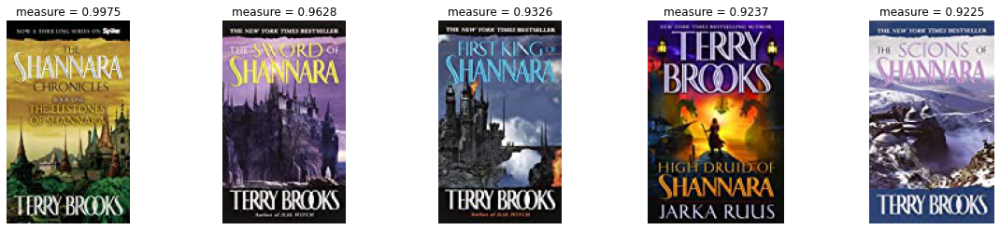

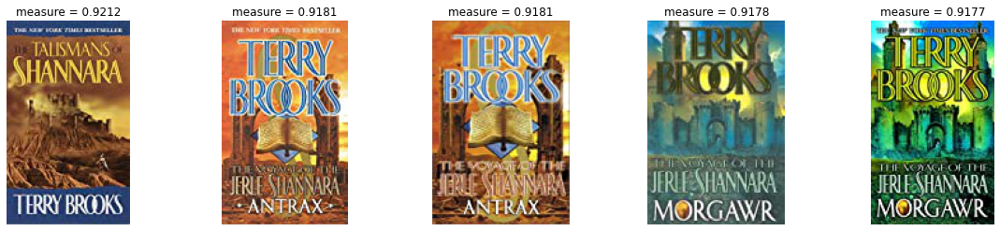

In [ ]:
CB.get_rec_U2I(3411)

# Коллаборативная фильтрация

In [ ]:
class Colloborative():
    def __init__(self, interactions):
        self.content_dict = {}
        for i, j in interactions[["product_id", "picture_url"]].drop_duplicates().values:
            self.content_dict[int(i)] = j

        self.csr_rates = coo_matrix((interactions["Book-Rating"], (interactions["vid"], interactions["product_id"])), 
                            shape = (len(set(interactions["vid"])), len(set(interactions["product_id"]))))
        

    def user_based(self, idx):
        user_rates = self.csr_rates.getrow(idx).toarray()[0]
        watched_items = np.where(user_rates != 0)[0]
        metrics = cosine_similarity([user_rates], self.csr_rates).reshape(-1, 1)
        csr_rates_centered = self.csr_rates.copy() - self.csr_rates.mean(axis = 1)
        rates = np.multiply(csr_rates_centered, metrics)
        rates = np.mean(user_rates) + np.array(np.sum(rates, axis = 0))[0]/np.sum(metrics, axis = 0)
        total_rate = (1 - user_rates.astype(bool)) * rates
        self.get_rec(watched_items, np.arange(self.csr_rates.shape[1])[np.argsort(total_rate)[::-1][:10]], np.sort(total_rate)[::-1][:10])

    def item_based(self, idx): 
        item_rates = self.csr_rates.getcol(idx).toarray().reshape(1, -1)
        metrics = cosine_similarity(item_rates, self.csr_rates.T).reshape(-1, 1)
        csr_rates_centered = self.csr_rates.copy() - self.csr_rates.mean(axis = 0)
        rates = np.multiply(csr_rates_centered.T, metrics)
        total_rate = np.mean(item_rates) + np.array(np.sum(rates, axis = 1))[:, 0]/np.sum(metrics)
        self.get_rec([idx], np.arange(self.csr_rates.shape[1])[np.argsort(total_rate)[::-1][:10]], np.sort(total_rate)[::-1][:10])

    def get_rec(self, watched, recs, measure):
        print(u"Для таких товаров")
        rec_imaging([i for i in watched], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging([i for i in recs], self.content_dict, measure)

In [ ]:
clb = Colloborative(Int)

Для таких товаров


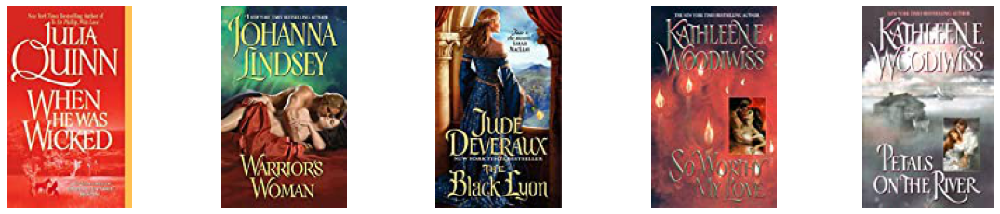

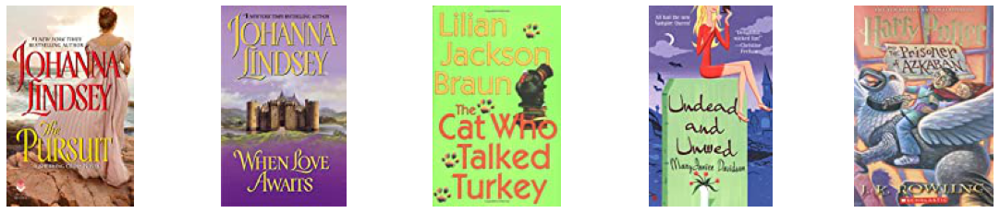

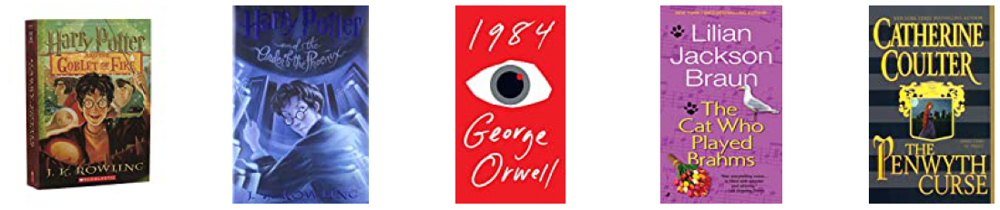

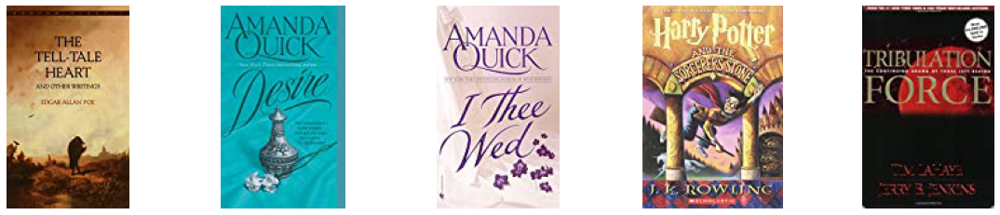

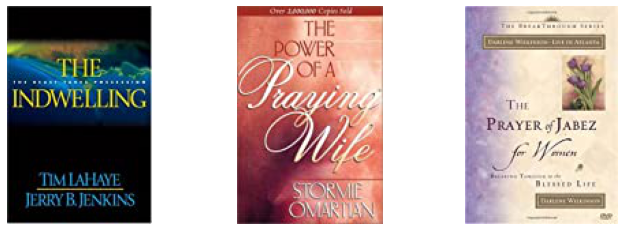

Такие рекомендации


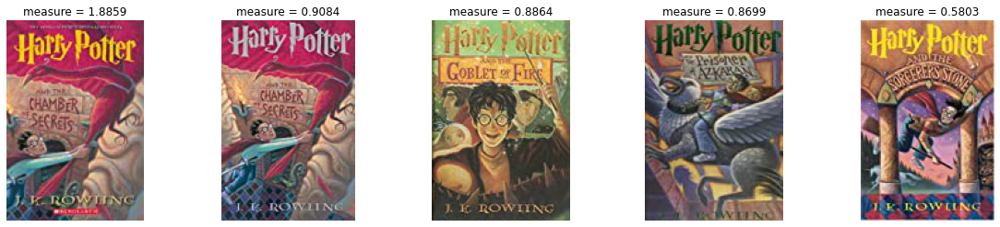

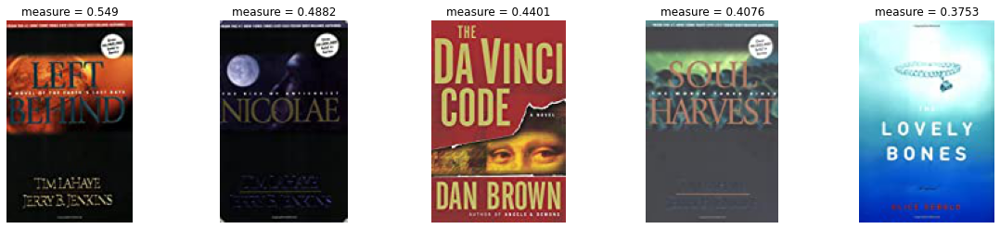

In [ ]:
clb.user_based(345)

Для таких товаров


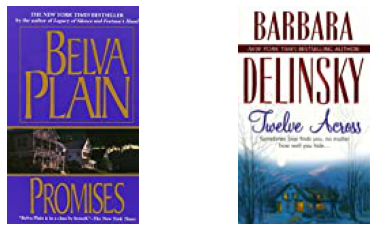

Такие рекомендации


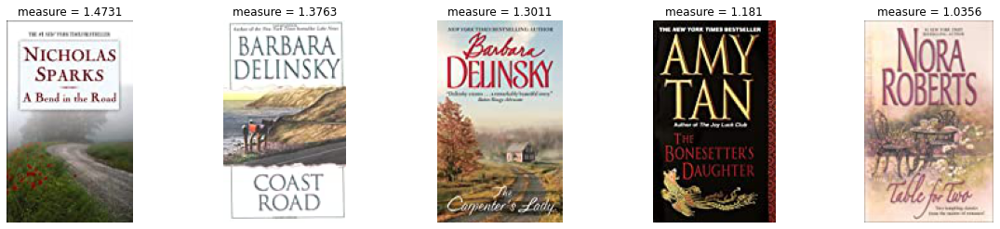

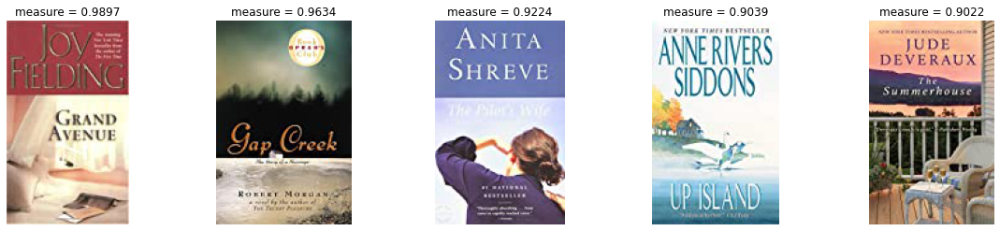

In [ ]:
clb.user_based(2356)

Для таких товаров


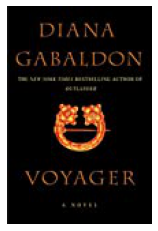

Такие рекомендации


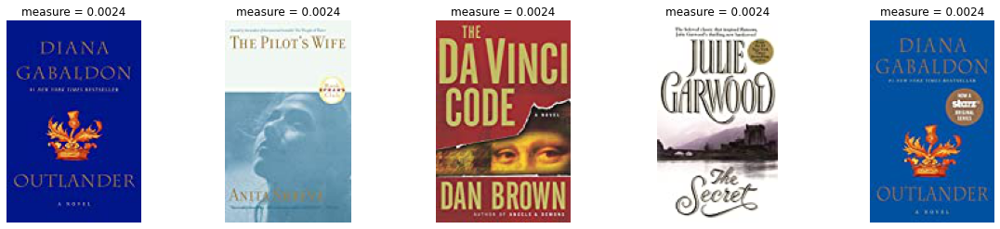

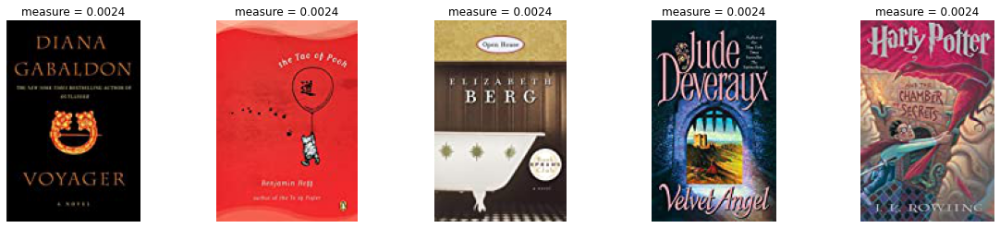

In [ ]:
clb.item_based(3173)

Для таких товаров


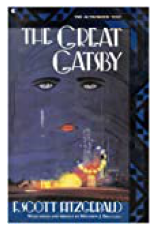

Такие рекомендации


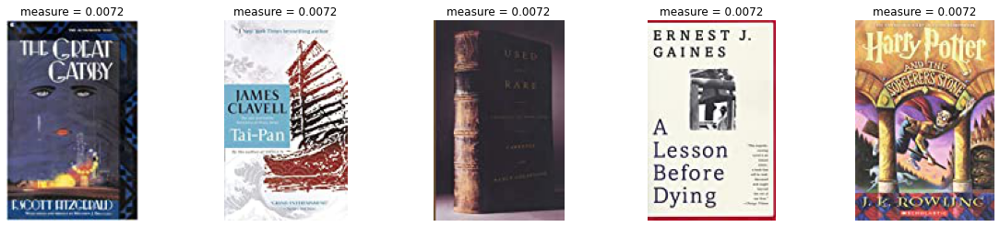

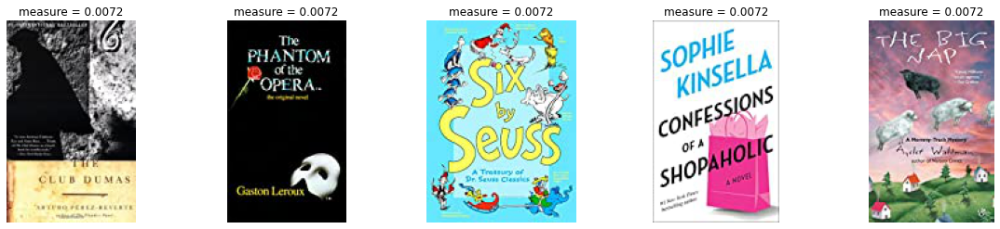

In [ ]:
clb.item_based(12)

# Матричная Факторизация

In [ ]:
class MatrixFactorization():
    
    def __init__(self, interactions, k):
        interactions["product_id"] = interactions["product_id"].astype(int)
        self.k = k
        self.content_dict = {}
        
        for i, j in interactions[["product_id", "picture_url"]].drop_duplicates().values:
            self.content_dict[i] = j
  
        self.csr_rates = coo_matrix((interactions["Book-Rating"], (interactions["vid"], interactions["product_id"])), 
                            shape = (len(set(interactions["vid"])), len(set(interactions["product_id"]))))
        
    def MF(self):
        U, S, V = svds(self.csr_rates.astype(float), k = self.k)
        self.user_embs = U
        self.items_embs = V.T

    def get_rec_U2I(self, i):
        metrics = cosine_similarity([self.user_embs[i]], self.user_embs)
        print(u"Для товара")
        rec_imaging([i], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(np.argsort(-metrics)[0][1:11], self.content_dict, -np.round(np.sort(-metrics)[0][1:11], 4))        
        
    def get_rec_I2I(self, i):
        metrics = cosine_similarity([self.items_embs[i]], self.items_embs)
        print(u"Для товара")
        rec_imaging([i], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(np.argsort(-metrics)[0][1:11], self.content_dict, -np.round(np.sort(-metrics)[0][1:11], 4))

In [ ]:
simple_svd = MatrixFactorization(Int, 30)
simple_svd.MF()

Для товара


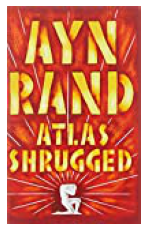

Такие рекомендации


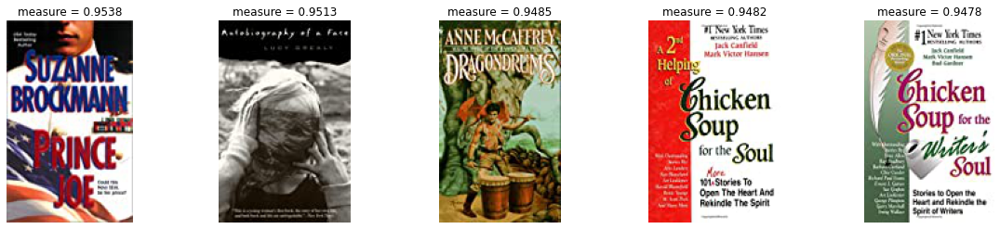

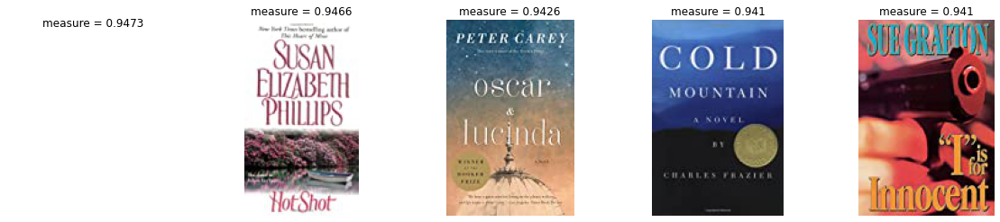

In [ ]:
simple_svd.get_rec_U2I(5439)

Для товара


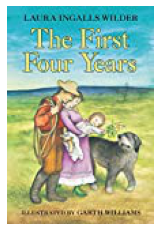

Такие рекомендации


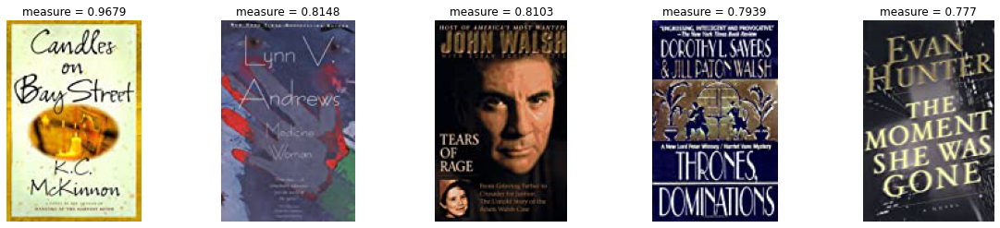

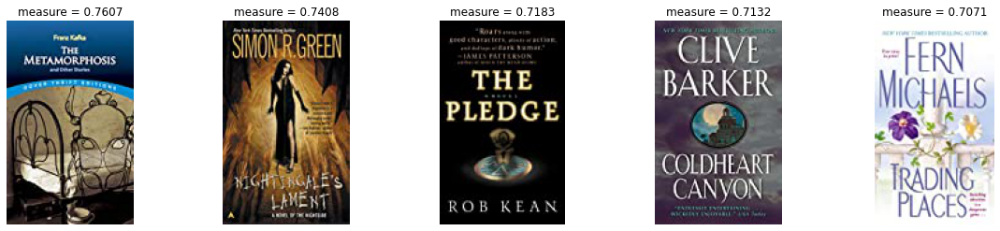

In [ ]:
simple_svd.get_rec_U2I(666)

Для товара


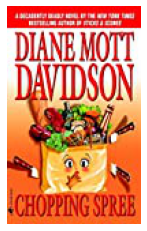

Такие рекомендации


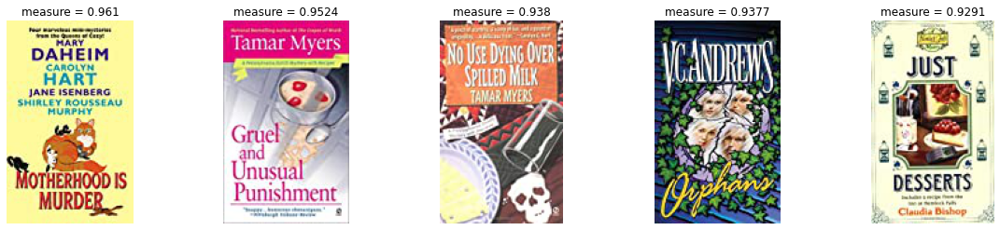

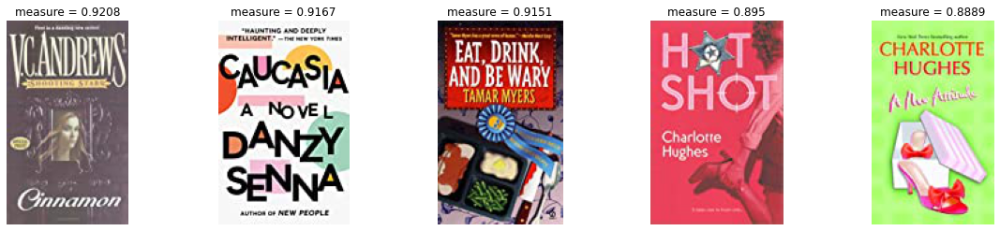

In [ ]:
simple_svd.get_rec_I2I(6789)

Для товара


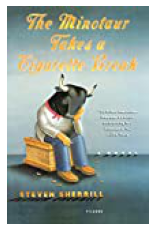

Такие рекомендации


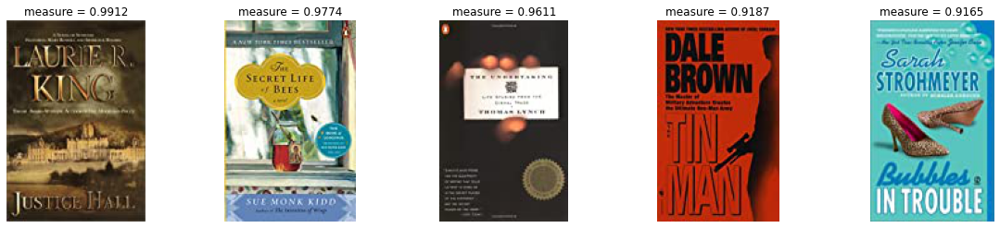

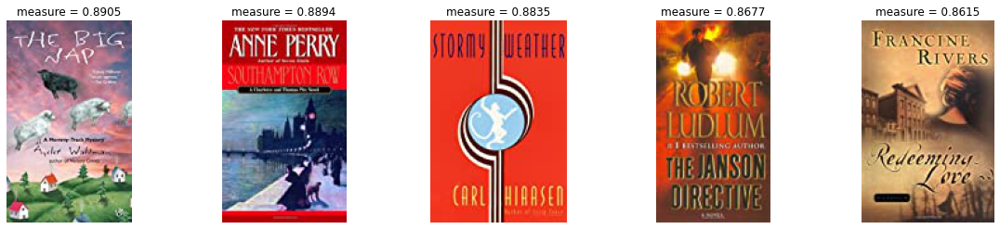

In [ ]:
simple_svd.get_rec_I2I(1400)

Для товара


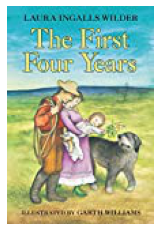

Такие рекомендации


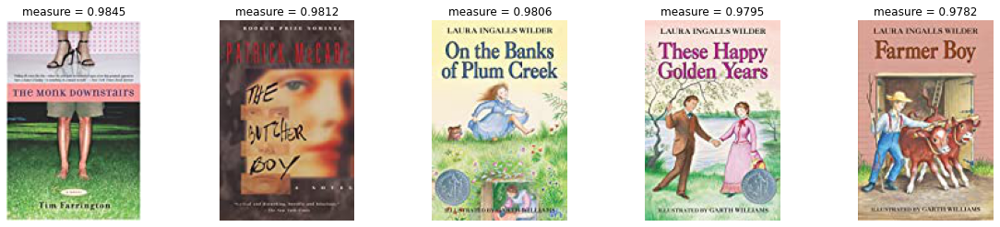

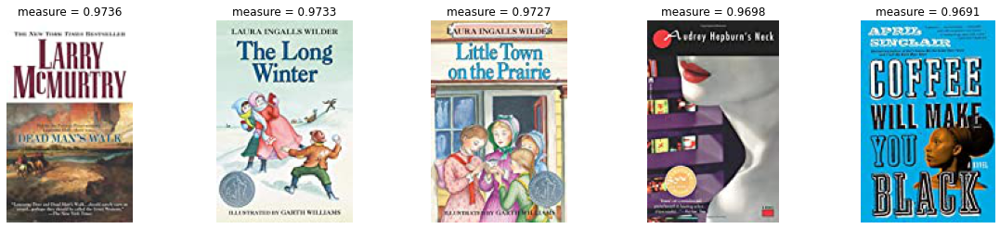

In [ ]:
simple_svd.get_rec_I2I(666)